In [1]:
#Importing Packages

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import os

In [2]:
#Importing Datasets

files = os.listdir(r'A:\DataScience Projects\UberData')[-7:]
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [3]:
files.remove('uber-raw-data-janjune-15.csv')
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [4]:
#Concatenate all the 6 datasets into a dataframe using for loop.

path = r'A:\DataScience Projects\UberData'
final = pd.DataFrame()
for file in files:
    df = pd.read_csv(path+'/'+file,encoding = 'utf-8')
    final = pd.concat([df,final])   ##Contains all the concatenated data

In [5]:
final.shape

(4534327, 4)

##### Lat : The latitude of the Uber pickup

##### Lon : The longitude of the Uber pickup

##### Base : The TLC base company code affiliated with the Uber pickup

In [6]:
df = final.copy()
df.head()

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512
3,9/1/2014 0:06:00,40.7450,-73.9889,B02512
4,9/1/2014 0:11:00,40.8145,-73.9444,B02512


In [7]:
df.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [8]:
df['Date/Time']= pd.to_datetime(df['Date/Time'],format = '%m/%d/%Y %H:%M:%S')       
                                                  #Converting to Date time format.

In [9]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

In [10]:
df.head()

,Date/Time,Lat,Lon,Base
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512


In [11]:
#Creating seprate columns in the dataset for weekday, month, day, hour and minute

df['Weekday']=df['Date/Time'].dt.day_name()
df['Month']=df['Date/Time'].dt.month
df['Day']= df['Date/Time'].dt.day
df['Hour']=df['Date/Time'].dt.hour
df['Minute'] = df['Date/Time'].dt.minute


In [12]:
df.head()

,Date/Time,Lat,Lon,Base,Weekday,Month,Day,Hour,Minute
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,9,1,0,1
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,9,1,0,1
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,9,1,0,3
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,9,1,0,6
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,9,1,0,11


In [13]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
Weekday              object
Month                 int64
Day                   int64
Hour                  int64
Minute                int64
dtype: object

#### Analysis of Journey by Weekdays

In [14]:
df['Weekday'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: Weekday, dtype: int64

In [15]:
df['Weekday'].value_counts().index

Index(['Thursday', 'Friday', 'Wednesday', 'Tuesday', 'Saturday', 'Monday',
       'Sunday'],
      dtype='object')

<Figure size 504x432 with 0 Axes>

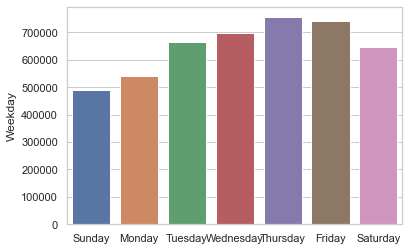

<Figure size 504x432 with 0 Axes>

In [16]:
sns.set_theme(style="whitegrid")
sns.barplot(x = df['Weekday'].value_counts().index,y = df['Weekday'].value_counts(),
            order = ['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday'])
plt.figure(figsize=(7,6))

In [17]:
px.bar(x = df['Weekday'].value_counts().index,y = df['Weekday'].value_counts())
            

After observing the barplots, we can conclude that the rush in Uber is highest on Thursdays.

#### Analysis of Journey by Hours.

[Text(0.5, 1.0, 'Journeys per Hours')]

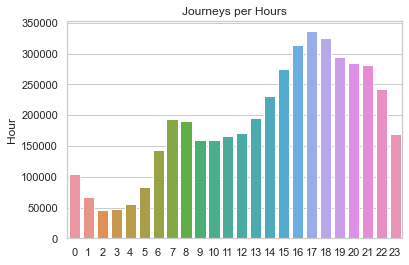

In [18]:
sns.set_theme(style="whitegrid")
sns.barplot(x = df['Hour'].value_counts().index,y = df['Hour'].value_counts()).set(title = 'Journeys per Hours')

After observing the barplot, we can conclude that the passengers/rush in Uber is at peak during 5 pm.

In [19]:
df['Month'].unique()

array([9, 5, 6, 7, 8, 4], dtype=int64)

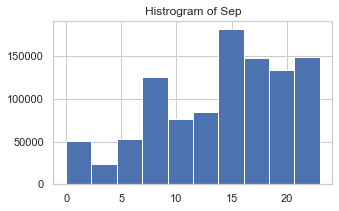

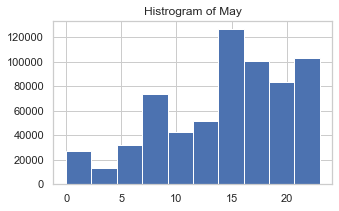

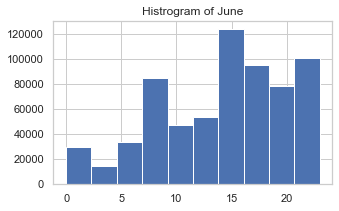

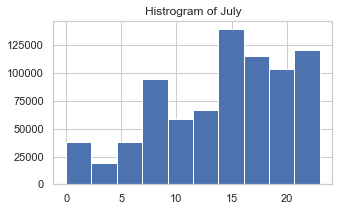

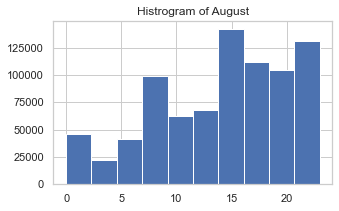

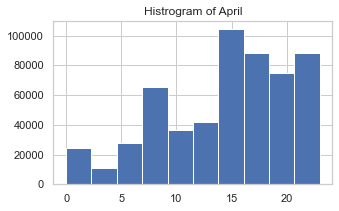

In [20]:
    month={9:'Sep',5:'May',6:'June',7:'July',8:'August',4:'April'}
    for i in df['Month'].unique():
        plt.figure(figsize=(5,3))
        df[df['Month']==i]['Hour'].hist()
        plt.title('Histrogram of {}'.format(month[i]))

For each month,we can see that the peak hours for rush is in the evening.

### Which month has maximum rides?

In [21]:
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [22]:
x = df.groupby('Month')['Hour'].count().index
y = df.groupby('Month')['Hour'].count()
x , y

(Int64Index([4, 5, 6, 7, 8, 9], dtype='int64', name='Month'),
 Month
 4     564516
 5     652435
 6     663844
 7     796121
 8     829275
 9    1028136
 Name: Hour, dtype: int64)

In [23]:
trace1 = go.Bar( 
        x = df.groupby('Month')['Hour'].count().index,
        y = df.groupby('Month')['Hour'].count(),
        name= 'Priority')
iplot([trace1])

Therefore,we can clearly see that the 9th month i.e. Septmeber has most rides.

### Analysis of journey of each day

Text(0.5, 1.0, 'Journeys by Month Day')

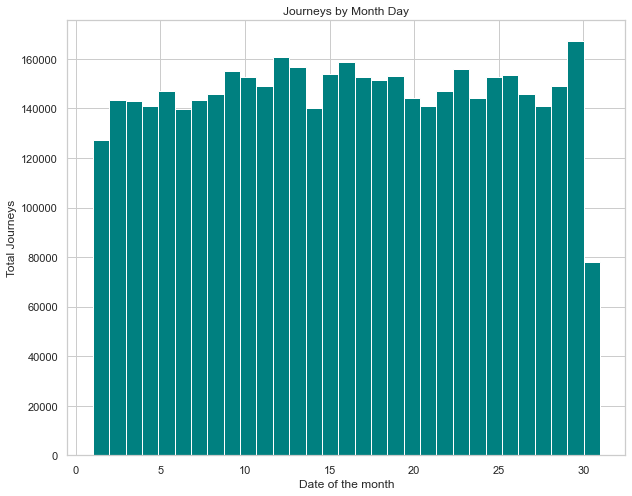

In [24]:
plt.figure(figsize=(10,8))
plt.hist(df['Day'], bins=31,color = 'teal')
plt.xlabel('Date of the month')
plt.ylabel('Total Journeys')
plt.title('Journeys by Month Day')

### Total Rides month wise

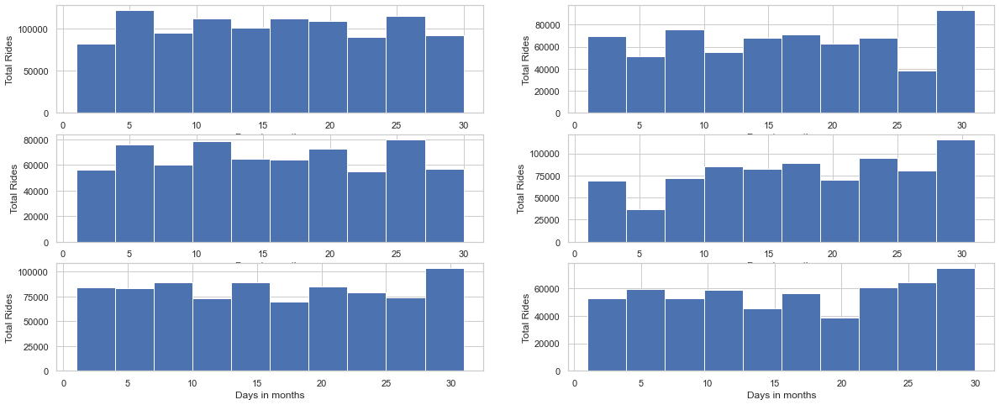

In [25]:
plt.figure(figsize = (20,8))
for i,Month in enumerate (df['Month'].unique(),1):
    plt.subplot(3,2,i)
    df_cut= df[df['Month'] == Month]
    plt.hist(df_cut['Day'])
    plt.xlabel('Days in months'.format(month))
    plt.ylabel('Total Rides')  

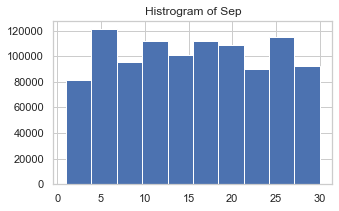

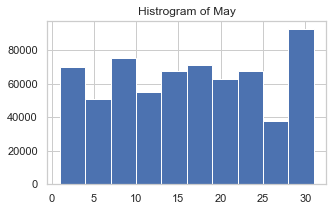

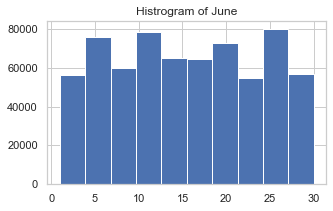

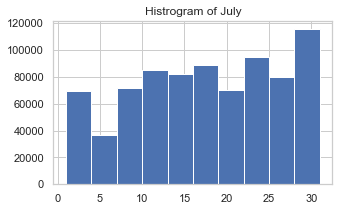

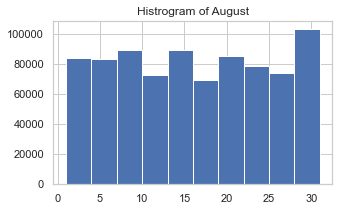

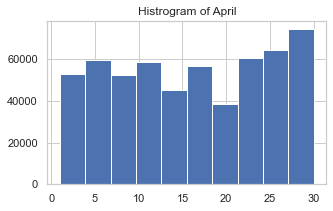

In [26]:
    month={9:'Sep',5:'May',6:'June',7:'July',8:'August',4:'April'}
    for i in df['Month'].unique():
        plt.figure(figsize=(5,3))
        df[df['Month']==i]['Day'].hist()
        plt.title('Histrogram of {}'.format(month[i]))

There are maximum rides at end of every month.

### Rush in hour

Text(0.5, 1.0, 'Hoursoffday vs Latiitide of Ride')

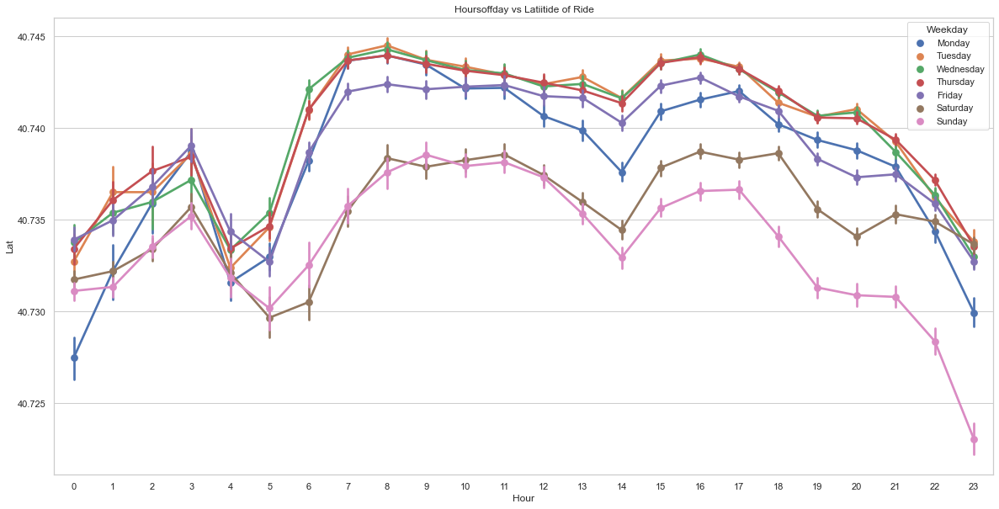

In [27]:
plt.figure(figsize= (20,10))
sns.set_style(style='whitegrid')
sns.pointplot(x='Hour',y= 'Lat',data=df,hue = 'Weekday',marker = '+').set_title('Hoursoffday vs Latiitide of Ride')
 
                                        ## This Pointplot give us idea of average latitudes.

                                    ## It means having more number of vehicle at this approximate latitude at this particular hour.

### Which base number gets popular by month name?


In [28]:
df.head()

,Date/Time,Lat,Lon,Base,Weekday,Month,Day,Hour,Minute
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,9,1,0,1
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,9,1,0,1
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,9,1,0,3
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,9,1,0,6
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,9,1,0,11


In [29]:
base = df.groupby(['Base','Month'])['Date/Time'].count().reset_index()

In [30]:
base.head()

,Base,Month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472


<AxesSubplot:xlabel='Month', ylabel='Date/Time'>

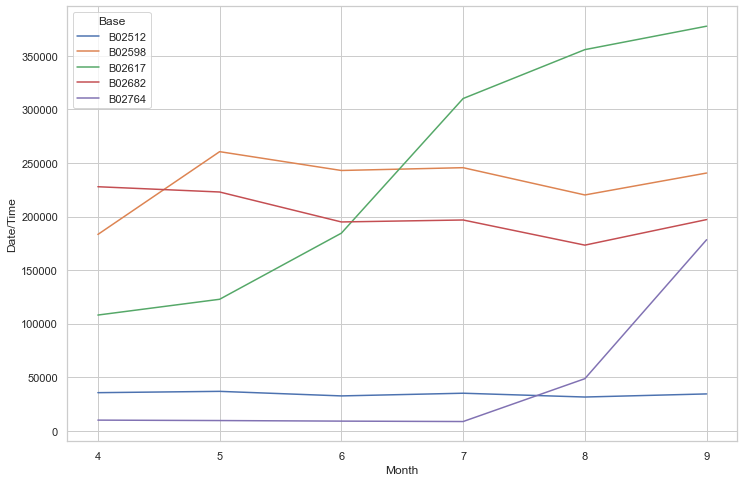

In [31]:
plt.figure(figsize = (12,8))
sns.lineplot(x = 'Month',y = 'Date/Time',hue = 'Base',data = base)

We can clearly see that the green line in the lineplot which represents 'B02617' base number gets popular by every month.

## Cross Analysis using heatmap 


In [32]:
def count_rows(rows):
    return len(rows)

In [33]:
cross1 = df.groupby(['Weekday','Hour']).apply(count_rows)

In [34]:
cross1

Weekday    Hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [35]:
pivot1 = cross1.unstack()

In [36]:
pivot1

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<AxesSubplot:xlabel='Hour', ylabel='Weekday'>

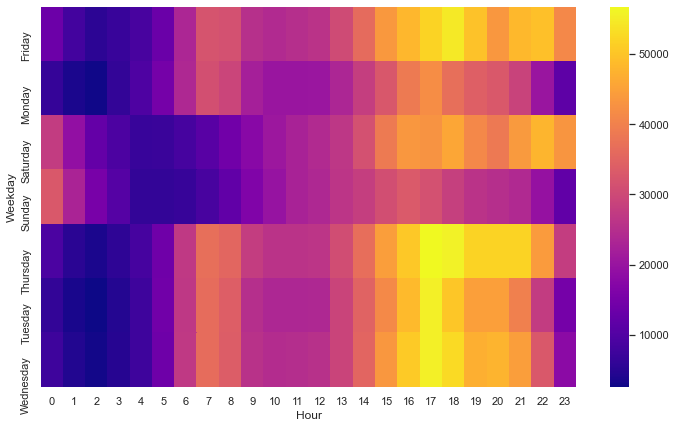

In [37]:
plt.figure(figsize = (12,7))
sns.heatmap(pivot1,cmap = 'plasma')           ###    Heatmap by Hour and week day

Most of the days the rides are more at highest during the day and eventually decrease by night.

In [38]:
def hm(col1,col2):
    '''
    Generate a heatmap of the two specified columns
    '''
    cross1 = df.groupby([col1,col2]).apply(count_rows) 
    pivot1 = cross1.unstack()
    plt.figure(figsize = (12,7))
    return (sns.heatmap(pivot1,cmap = 'plasma'))         

<AxesSubplot:xlabel='Hour', ylabel='Month'>

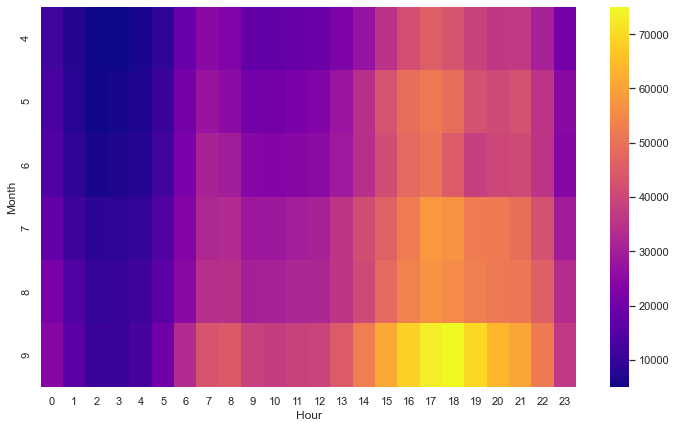

In [39]:
hm('Month','Hour')                        #Heatmap by month and hour

Rides were at peak during evening hours of September.

In [40]:
help(hm)

Help on function hm in module __main__:

hm(col1, col2)
    Generate a heatmap of the two specified columns



<AxesSubplot:xlabel='Weekday', ylabel='Month'>

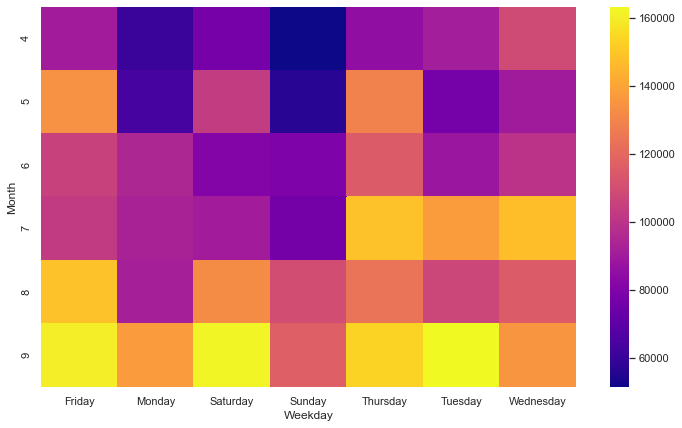

In [41]:
hm('Month','Weekday')                    #Heatmap by month and Weekday

<AxesSubplot:xlabel='Day', ylabel='Month'>

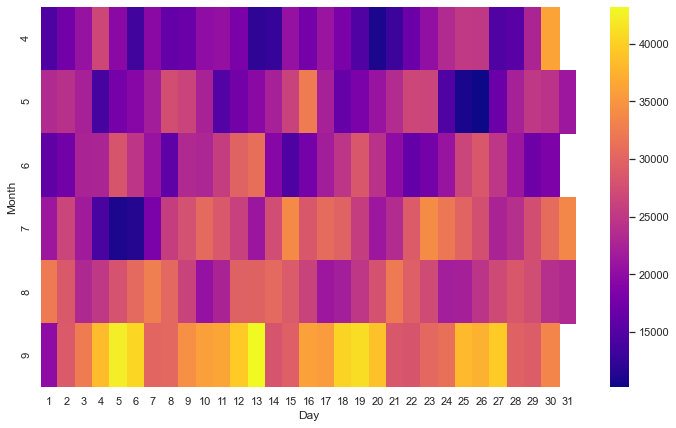

In [42]:
hm('Month','Day')

We observe that the number of trips increases each month, we can say that from April to September 2014, Uber was in a continuous improvement process.

### Analysis of location data points.


(40.6, 41.0)

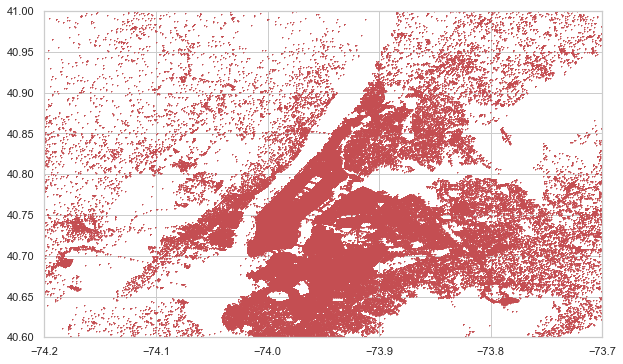

In [43]:
plt.figure(figsize=(10,6))

plt.plot(df['Lon'], df['Lat'],'r+', ms=1)
plt.xlim(-74.2, -73.7)
plt.ylim(40.6,41)

From the above heatmap we can see that Midtown Manhattan is the big spot of Uber rides.

#### Spatial Analysis

In [44]:
df_sun = df[df['Weekday']=='Sunday']
df_sun.head()

,Date/Time,Lat,Lon,Base,Weekday,Month,Day,Hour,Minute
8011,2014-09-07 00:00:00,40.7341,-74.0005,B02512,Sunday,9,7,0,0
8012,2014-09-07 00:00:00,40.7344,-73.9900,B02512,Sunday,9,7,0,0
8013,2014-09-07 00:00:00,40.7806,-73.9582,B02512,Sunday,9,7,0,0
8014,2014-09-07 00:01:00,40.7293,-73.9859,B02512,Sunday,9,7,0,1
8015,2014-09-07 00:01:00,40.7713,-74.0133,B02512,Sunday,9,7,0,1


In [45]:
df_sun.shape

(490180, 9)

In [46]:
rush = df_sun.groupby(['Lat','Lon'])['Weekday'].count().reset_index()

In [47]:
rush.head()

,Lat,Lon,Weekday
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1


In [48]:
rush.columns = ['Lat','Lon','No. of Trips']

In [49]:
rush.head()

,Lat,Lon,No. of Trips
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1


In [50]:
import folium as fy
from folium.plugins import HeatMap

In [51]:
basemap = fy.Map()
basemap

### Spatial Analysis

In [52]:
HeatMap(rush,radius = 20,zoom = 15,blur = 20).add_to(basemap)

In [53]:
basemap

#### Automate the analysis

In [54]:
def dayhm(df,day):
    basemap = fy.Map()
    df1 = df[df['Weekday']==day]
    HeatMap(df1.groupby(['Lat','Lon'])['Weekday'].count().reset_index(),radius = 20,zoom = 15,blur = 20).add_to(basemap)
    return (basemap)

In [55]:
dayhm(df,'Monday')

In [56]:
uber_15=pd.read_csv(r'A:\DataScience Projects\UberData\uber-raw-data-janjune-15.csv')

In [57]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [58]:
uber_15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [59]:
uber_15['Pickup_Date']= pd.to_datetime(uber_15['Pickup_date'],format = '%Y-%m-%d %H:%M:%S')

In [60]:
uber_15.dtypes

Dispatching_base_num            object
Pickup_date                     object
Affiliated_base_num             object
locationID                       int64
Pickup_Date             datetime64[ns]
dtype: object

In [61]:
uber_15['Weekday'] = uber_15['Pickup_Date'].dt.day_name()
uber_15['Month'] = uber_15['Pickup_Date'].dt.month
uber_15['Day'] = uber_15['Pickup_Date'].dt.day
uber_15['Hour'] = uber_15['Pickup_Date'].dt.hour
uber_15['Minute'] = uber_15['Pickup_Date'].dt.minute

In [62]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,Pickup_Date,Weekday,Month,Day,Hour,Minute
0,B02617,2015-05-17 09:47:00,B02617,141,2015-05-17 09:47:00,Sunday,5,17,9,47
1,B02617,2015-05-17 09:47:00,B02617,65,2015-05-17 09:47:00,Sunday,5,17,9,47
2,B02617,2015-05-17 09:47:00,B02617,100,2015-05-17 09:47:00,Sunday,5,17,9,47
3,B02617,2015-05-17 09:47:00,B02774,80,2015-05-17 09:47:00,Sunday,5,17,9,47
4,B02617,2015-05-17 09:47:00,B02617,90,2015-05-17 09:47:00,Sunday,5,17,9,47


#### Uber pickups by month in NYC

In [63]:
uber_15['Month'].value_counts()

6    2816895
5    2695553
4    2280837
2    2263620
3    2259773
1    1953801
Name: Month, dtype: int64

<AxesSubplot:ylabel='Month'>

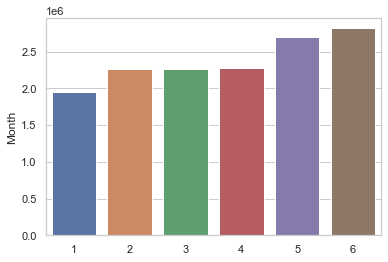

In [64]:
sns.barplot(y = uber_15['Month'].value_counts(),x = uber_15['Month'].value_counts().index)

We can conclude that June had the most pickups. 

### Rush in NYC in hours

C:\Users\laxma\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<Figure size 720x576 with 0 Axes>

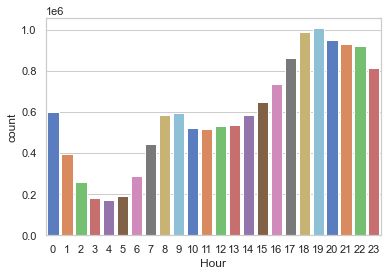

<Figure size 720x576 with 0 Axes>

In [65]:
sns.countplot(uber_15['Hour'],palette = 'muted')
plt.figure(figsize = (10,8))

There is a significant increase demand in the pickups at evening

#### Rush in NYC in day per hours

In [66]:
dph = uber_15.groupby(['Weekday','Hour'])['Pickup_Date'].count().reset_index()


In [67]:
dph.head()

,Weekday,Hour,Pickup_Date
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


<AxesSubplot:xlabel='Hour', ylabel='Pickup_Date'>

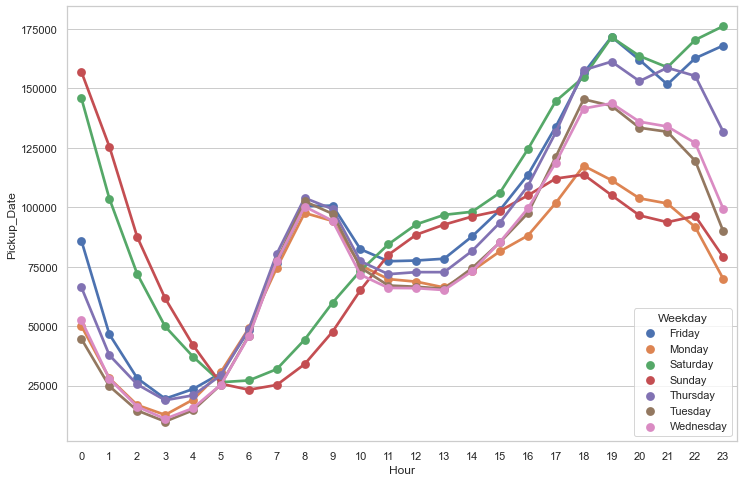

In [68]:
plt.figure(figsize = (12,8))
sns.pointplot(x = 'Hour',y = 'Pickup_Date',data = dph,hue = 'Weekday')

During weekdays there is more rush in the morning compared to weekends.

In [69]:
uber_foil = pd.read_csv(r'A:\DataScience Projects\UberData\Uber-Jan-Feb-FOIL.csv')

In [70]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


Which base number has the most active vehicles?

In [71]:
uber_foil['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

<AxesSubplot:xlabel='dispatching_base_number', ylabel='active_vehicles'>

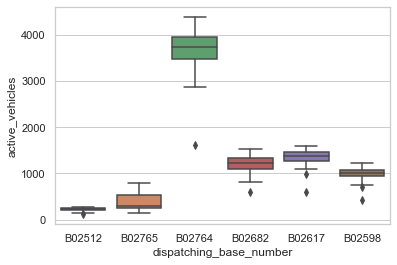

In [72]:
sns.boxplot(x = 'dispatching_base_number',y = 'active_vehicles',data = uber_foil)

Base number B02764 has the most active vehicles.

Which base number has the most trips?

<AxesSubplot:xlabel='dispatching_base_number', ylabel='trips'>

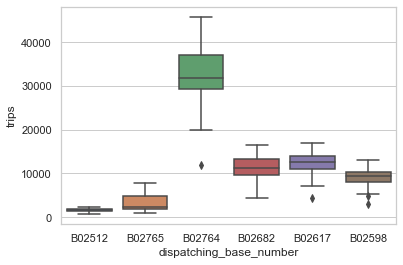

In [73]:
sns.boxplot(x = 'dispatching_base_number',y = 'trips',data = uber_foil)

Base number B02764 has the most trips.

In [74]:
uber_foil['trips/vehicles'] = uber_foil['trips']/uber_foil['active_vehicles']

In [75]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips,trips/vehicles
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


<Figure size 864x576 with 0 Axes>

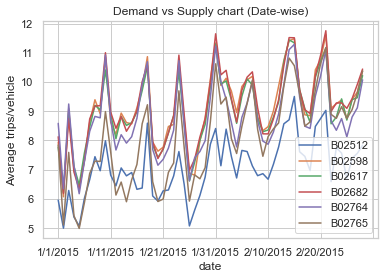

<Figure size 864x576 with 0 Axes>

In [76]:
uber_foil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicles'].plot()
plt.ylabel('Average trips/vehicle')
plt.title('Demand vs Supply chart (Date-wise)')
plt.legend()
plt.figure(figsize=(12,8))

B02764 & B02598 performs better